../data/SWED/test/images/S2A_MSIL2A_20200107T175721_N0213_R141_T12QVM_20200107T214721_image_0_0.tif
98


Loading data: 100%|██████████| 98/98 [00:00<00:00, 251.05it/s]


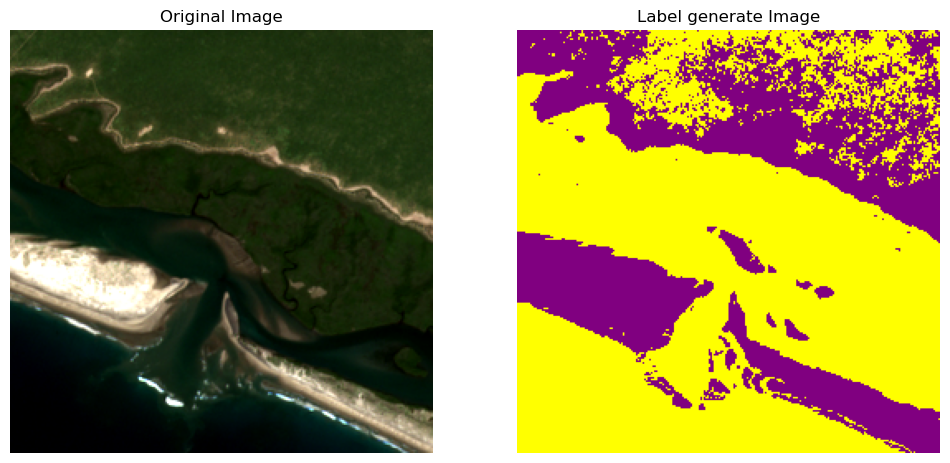

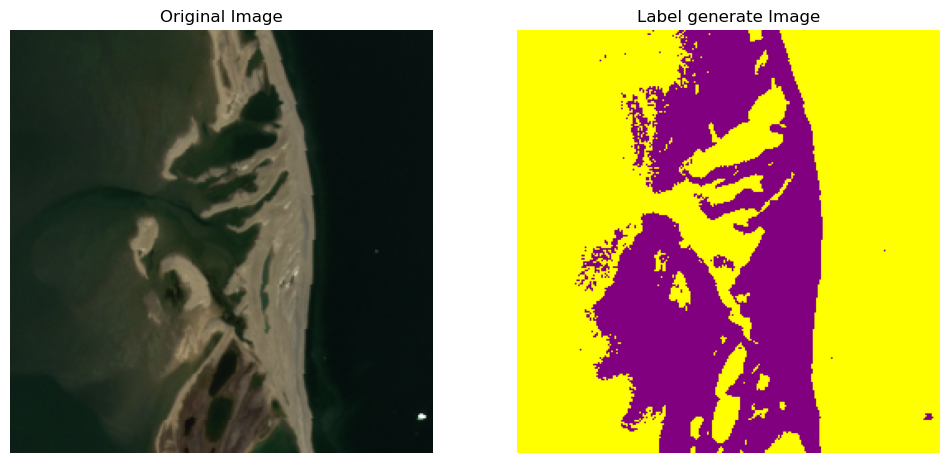

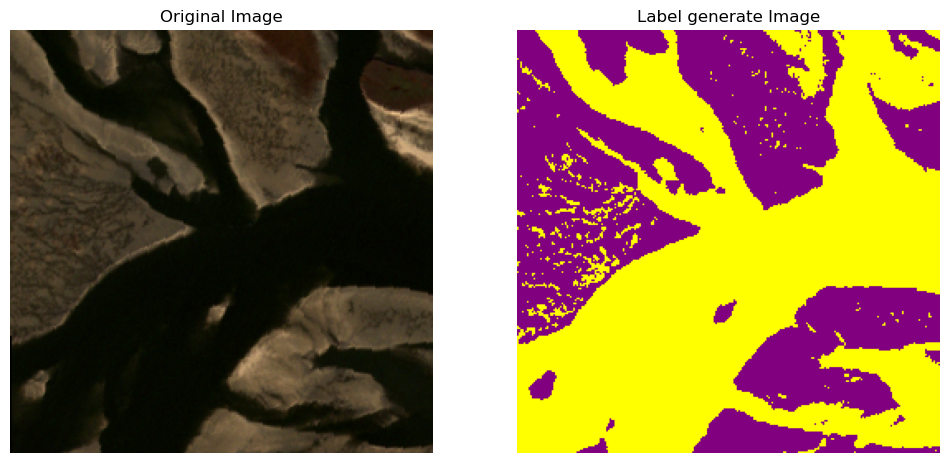

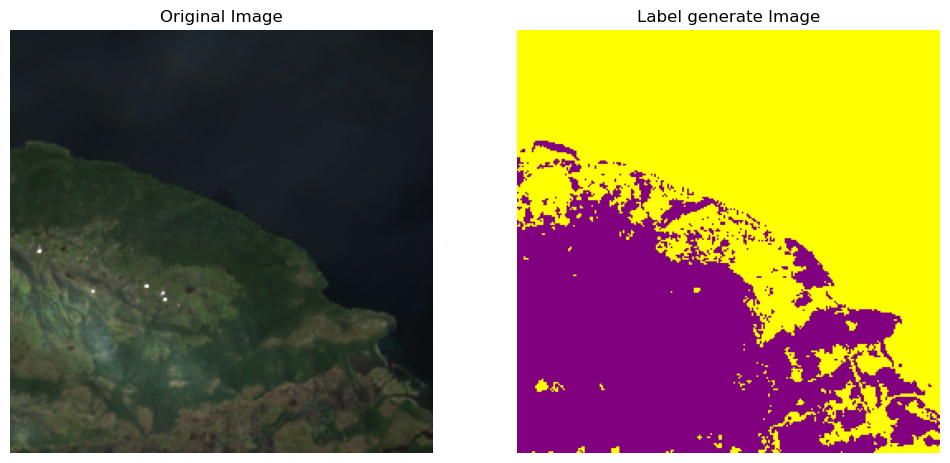

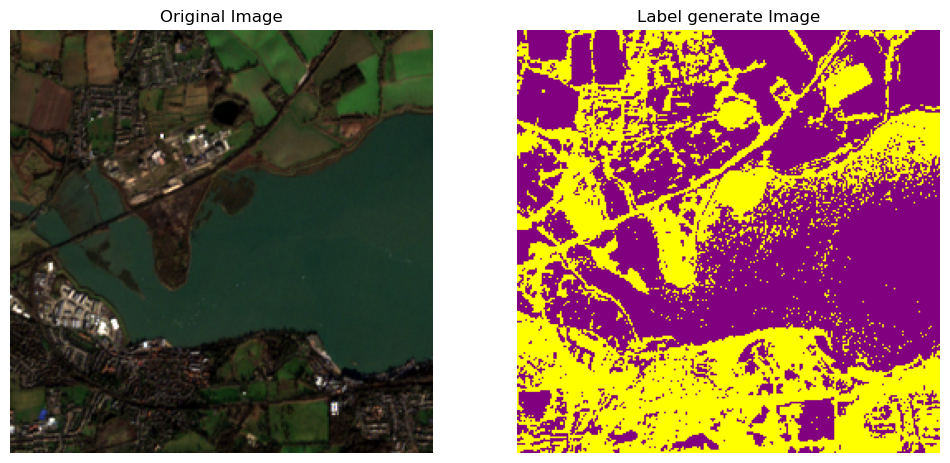

...

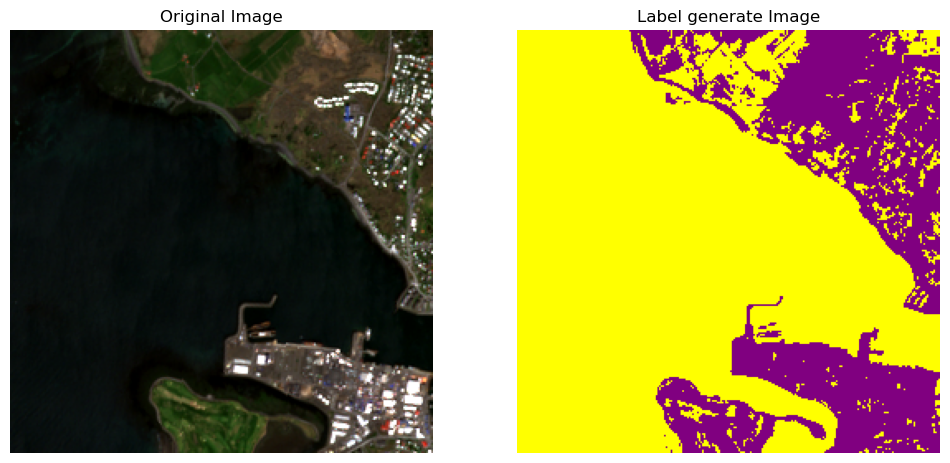

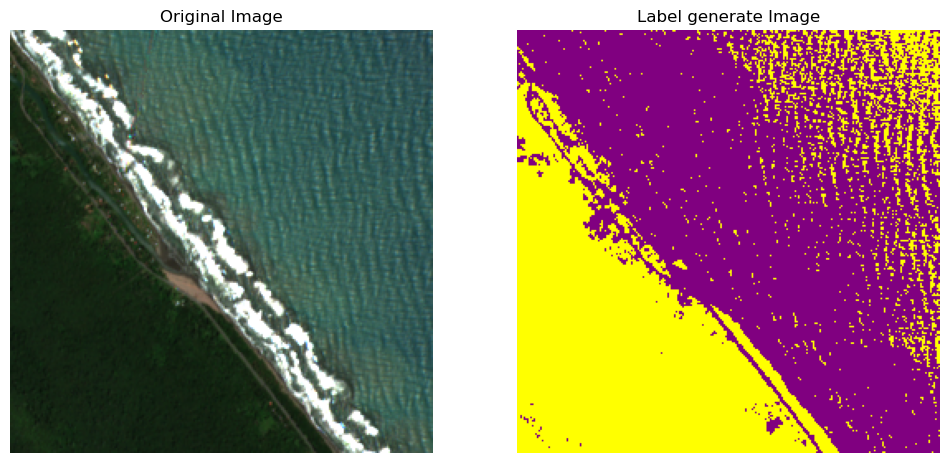

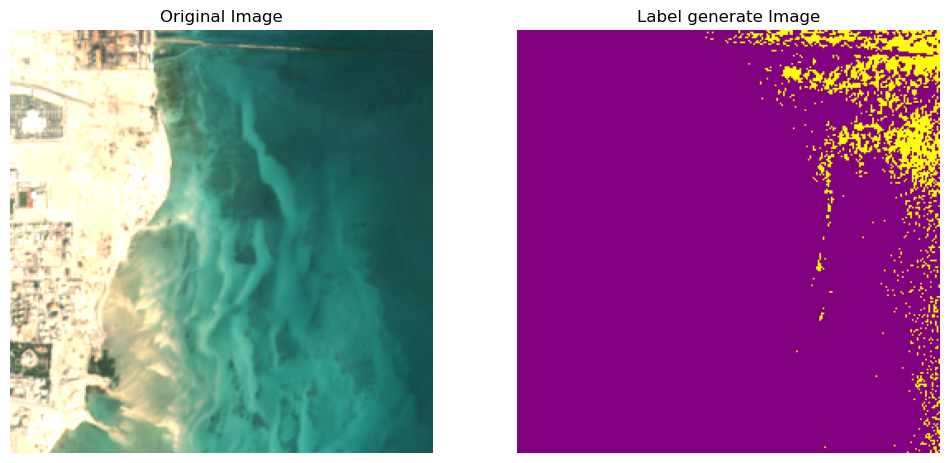

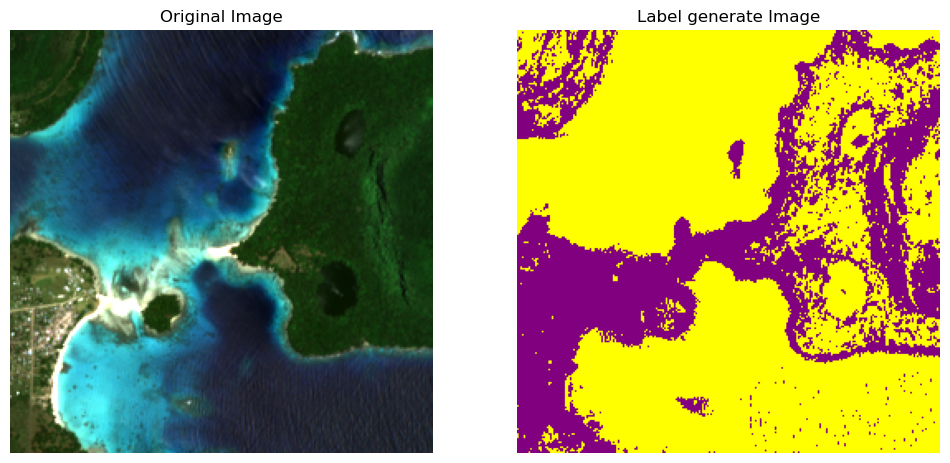

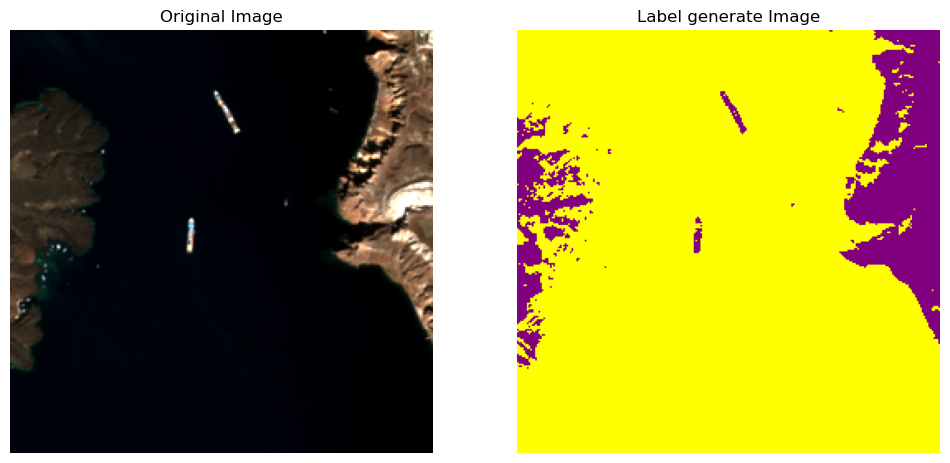

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
import glob
from tqdm import tqdm
from osgeo import gdal

# Function to load and preprocess images
def load_test(path):
    """Load and preprocess the satellite image."""
    img = gdal.Open(path).ReadAsArray()
    stack_img = np.stack(img, axis=-1)
    rgb_img = get_rgb(stack_img)
    label_path = path.replace("images", "labels").replace("image", "label")
    label = gdal.Open(label_path).ReadAsArray() if os.path.exists(label_path) else None
    return stack_img, rgb_img, label

def get_rgb(img):
    """Normalize RGB channels from the sentinel image and convert to uint8."""
    rgb_img = img[:, :, [3,2,1]]
    rgb_normalize = np.clip(rgb_img / 10000, 0, 0.3) / 0.3
    return (rgb_normalize * 255).astype(np.uint8)  # Convert to uint8

# Load images and labels
def load_data():
    """Load all images and labels from the specified directory."""
    test_path = glob.glob("../data/SWED/test/images/*")
    print(test_path[0])
    print(len(test_path))

    input_images = []
    rgb_images = []
    labels = []
    image_names = []

    for path in tqdm(test_path, desc="Loading data"):
        try:
            img, rgb_img, label = load_test(path)
            input_images.append(img)
            rgb_images.append(rgb_img)
            labels.append(label)
            image_names.append(os.path.basename(path))  # Store image name
        except Exception as e:
            print(f"Error with image {path}: {e}")

    return rgb_images, labels, image_names

# Function to generate label image where blue water becomes yellow and land becomes violet
def generate_label(image):
    """Generate label image where water is yellow and land is violet."""
    # Convert the image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    # Define multiple color ranges for detecting different shades of blue and dark areas
    lower_blue1 = np.array([90, 50, 50])
    upper_blue1 = np.array([130, 255, 255])
    
    lower_blue2 = np.array([90, 50, 50])
    upper_blue2 = np.array([110, 255, 255])
    
    lower_blue3 = np.array([100, 50, 50])
    upper_blue3 = np.array([140, 255, 255])
    
    # Include a range for dark areas (e.g., water at night)
    lower_dark = np.array([0, 0, 0])
    upper_dark = np.array([180, 255, 50])
    
    # Create masks for the different blue ranges and dark areas
    mask_blue1 = cv2.inRange(hsv_image, lower_blue1, upper_blue1)
    mask_blue2 = cv2.inRange(hsv_image, lower_blue2, upper_blue2)
    mask_blue3 = cv2.inRange(hsv_image, lower_blue3, upper_blue3)
    mask_dark = cv2.inRange(hsv_image, lower_dark, upper_dark)
    
    # Combine the masks
    mask_water = cv2.bitwise_or(mask_blue1, mask_blue2)
    mask_water = cv2.bitwise_or(mask_water, mask_blue3)
    mask_water = cv2.bitwise_or(mask_water, mask_dark)
    
    # Initialize the label image with the same dimensions as the input image
    label_image = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)
    
    # Set water regions to yellow (R=255, G=255, B=0)
    label_image[mask_water > 0] = [255, 255, 0]
    
    # Set land regions to violet (R=128, G=0, B=128)
    label_image[mask_water == 0] = [128, 0, 128]
    
    return label_image

# Load and preprocess the data
rgb_images, labels, image_names = load_data()

# Create output directory if it doesn't exist
output_dir = "../data/SWED/label_image_generate/"
os.makedirs(output_dir, exist_ok=True)

# Process each image and save the generated label
for rgb_image, image_name in zip(rgb_images, image_names):
    label_image = generate_label(rgb_image)
    output_path = os.path.join(output_dir, image_name.replace(".png", "_label_generate.png"))
    cv2.imwrite(output_path, label_image)

    # Display the original and label images
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(rgb_image)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Label generate Image')
    plt.imshow(label_image)
    plt.axis('off')

    plt.show()
